#### Importation des librairies :

In [2]:
pip install seaborn

  Using cached seaborn-0.13.2-py3-none-any.whl.metadata (5.4 kB)
Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
Note: you may need to restart the kernel to use updated packages.


In [3]:
!pip install scikit-learn

In [21]:
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#### Importation du fichier : 

In [5]:
# Chemin vers le dossier contenant les fichiers extraits
dossier_data = "C:/Users/paulm/Documents/GitHub/Projet7/data"

# Liste des fichiers dans le dossier data
fichiers_data = os.listdir(dossier_data)
print(f"Fichiers dans le dossier data : {fichiers_data}")

chemin_fichier_train = os.path.join(dossier_data, 'application_test.csv')
train_data = pd.read_csv(chemin_fichier_train)

# Affichage des premières lignes du DataFrame pour vérifier que le fichier a été chargé correctement
print(train_data.head())

Fichiers dans le dossier data : ['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'processed_data.csv', 'Projet+Mise+en+prod+-+home-credit-default-risk (1).zip', 'sample_submission.csv']
   SK_ID_CURR NAME_CONTRACT_TYPE CODE_GENDER FLAG_OWN_CAR FLAG_OWN_REALTY  \
0      100001         Cash loans           F            N               Y   
1      100005         Cash loans           M            N               Y   
2      100013         Cash loans           M            Y               Y   
3      100028         Cash loans           F            N               Y   
4      100038         Cash loans           M            Y               N   

   CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  AMT_ANNUITY  AMT_GOODS_PRICE  \
0             0          135000.0    568800.0      20560.5         450000.0   
1         

#### Examination des distributions : 

Fichiers dans le dossier data : ['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'processed_data.csv', 'Projet+Mise+en+prod+-+home-credit-default-risk (1).zip', 'sample_submission.csv']
Training data shape:  (307511, 122)
   SK_ID_CURR  TARGET NAME_CONTRACT_TYPE CODE_GENDER FLAG_OWN_CAR  \
0      100002       1         Cash loans           M            N   
1      100003       0         Cash loans           F            N   
2      100004       0    Revolving loans           M            Y   
3      100006       0         Cash loans           F            N   
4      100007       0         Cash loans           M            N   

  FLAG_OWN_REALTY  CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  AMT_ANNUITY  \
0               Y             0          202500.0    406597.5      24700.5   
1               N       

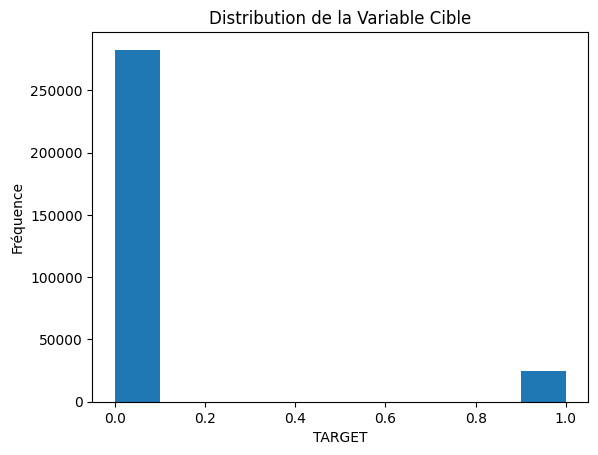

In [6]:
# Chemin vers le dossier contenant les fichiers extraits
dossier_data = "C:/Users/paulm/Documents/GitHub/Projet7/data"

# Liste des fichiers dans le dossier data
fichiers_data = os.listdir(dossier_data)
print(f"Fichiers dans le dossier data : {fichiers_data}")

# Charger les données d'entraînement
chemin_fichier_train = os.path.join(dossier_data, 'application_train.csv')
app_train = pd.read_csv(chemin_fichier_train)
print('Training data shape: ', app_train.shape)
print(app_train.head())

# Charger les données de test
chemin_fichier_test = os.path.join(dossier_data, 'application_test.csv')
app_test = pd.read_csv(chemin_fichier_test)
print('Testing data shape: ', app_test.shape)
print(app_test.head())

# Compter les valeurs de la variable cible
print(app_train['TARGET'].value_counts())

# Visualiser la distribution de la variable cible
app_train['TARGET'].astype(int).plot.hist()
plt.title('Distribution de la Variable Cible')
plt.xlabel('TARGET')
plt.ylabel('Fréquence')
plt.show()

#### Examination des valeurs manquantes : 

In [7]:
# Fonction pour calculer les valeurs manquantes par colonne
def missing_values_table(df):
    # Valeurs manquantes totales
    mis_val = df.isnull().sum()
    
    # Pourcentage de valeurs manquantes
    mis_val_percent = 100 * df.isnull().sum() / len(df)
    
    # Créer un tableau avec les résultats
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
    
    # Renommer les colonnes
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values'})
    
    # Trier le tableau par pourcentage de valeurs manquantes par ordre décroissant
    mis_val_table_ren_columns = mis_val_table_ren_columns[
        mis_val_table_ren_columns.iloc[:, 1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)
    
    # Afficher un résumé
    print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
        "There are " + str(mis_val_table_ren_columns.shape[0]) +
          " columns that have missing values.")
    
    # Retourner le tableau avec les informations des valeurs manquantes
    return mis_val_table_ren_columns

# Statistiques des valeurs manquantes
missing_values = missing_values_table(app_train)
print(missing_values.head(20))

Your selected dataframe has 122 columns.
There are 67 columns that have missing values.
                          Missing Values  % of Total Values
COMMONAREA_MEDI                   214865               69.9
COMMONAREA_AVG                    214865               69.9
COMMONAREA_MODE                   214865               69.9
NONLIVINGAPARTMENTS_MEDI          213514               69.4
NONLIVINGAPARTMENTS_MODE          213514               69.4
NONLIVINGAPARTMENTS_AVG           213514               69.4
FONDKAPREMONT_MODE                210295               68.4
LIVINGAPARTMENTS_MODE             210199               68.4
LIVINGAPARTMENTS_MEDI             210199               68.4
LIVINGAPARTMENTS_AVG              210199               68.4
FLOORSMIN_MODE                    208642               67.8
FLOORSMIN_MEDI                    208642               67.8
FLOORSMIN_AVG                     208642               67.8
YEARS_BUILD_MODE                  204488               66.5
YEARS_BUILD_

In [8]:
# colonnes type :
app_train.dtypes.value_counts()

float64    65
int64      41
object     16
Name: count, dtype: int64

In [9]:
# Nombre de classe unique pour chaques colonnes :
app_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

In [10]:
# Encodage des étiquettes pour les colonnes avec 2 catégories uniques
le = LabelEncoder()
le_count = 0

# Parcourir les colonnes du jeu de données d'entraînement
for col in app_train:
    if app_train[col].dtype == 'object':
        # Si la colonne a 2 catégories uniques ou moins
        if len(list(app_train[col].unique())) <= 2:
            # Entraîner l'encodeur sur les données d'entraînement
            le.fit(app_train[col])
            # Transformer les données d'entraînement et de test
            app_train[col] = le.transform(app_train[col])
            app_test[col] = le.transform(app_test[col])
            
            # Compter le nombre de colonnes encodées
            le_count += 1
             
print('%d columns were label encoded.' % le_count)

# Encodage one-hot des variables catégorielles
app_train = pd.get_dummies(app_train)
app_test = pd.get_dummies(app_test)

print('Training Features shape: ', app_train.shape)
print('Testing Features shape: ', app_test.shape)

3 columns were label encoded.
Training Features shape:  (307511, 243)
Testing Features shape:  (48744, 239)


In [11]:
train_labels = app_train['TARGET']

# Align the training and testing data, keep only columns present in both dataframes
app_train, app_test = app_train.align(app_test, join = 'inner', axis = 1)

# Add the target back in
app_train['TARGET'] = train_labels

print('Training Features shape: ', app_train.shape)
print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 240)
Testing Features shape:  (48744, 239)


#### Retour sur l'analyse exploratoire : 

In [12]:
(app_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

Ces âges semblent raisonnables. Il n’y a pas de valeurs aberrantes pour l’âge, que ce soit dans le haut ou le bas.

Et les jours de travail ?

In [13]:
app_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

Il semble ici avoir un problème. La valeur maximale (en plus d'être positive) est d'environ 1000 ans !

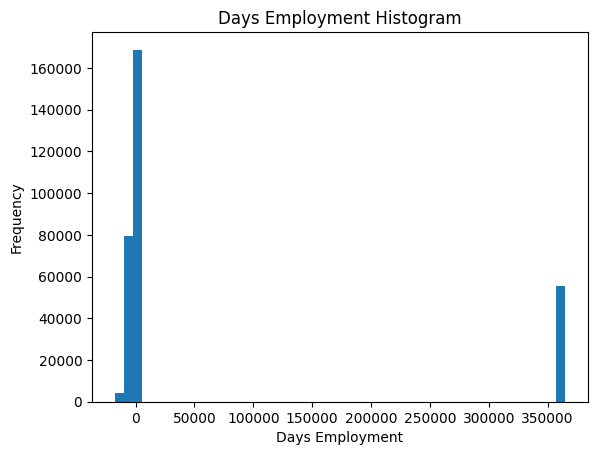

In [14]:
app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram', bins=50);
plt.xlabel('Days Employment');

Par curiosité, divisons les clients anormaux et voyons s'ils ont tendance à avoir des taux de défaut plus élevés ou plus faibles que le reste des clients.

In [15]:
anom = app_train[app_train['DAYS_EMPLOYED'] == 365243]
non_anom = app_train[app_train['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Eh bien, c'est extrêmement intéressant ! Il s’avère que les anomalies ont un taux de défaut plus faible.

La gestion des anomalies dépend de la situation exacte, sans règles définies. L'une des approches les plus sûres consiste simplement à définir les anomalies sur une valeur manquante, puis à les remplir (à l'aide de l'imputation) avant l'apprentissage automatique. Dans ce cas, puisque toutes les anomalies ont exactement la même valeur, nous souhaitons les remplir avec la même valeur au cas où tous ces prêts partageraient quelque chose en commun. Les valeurs anormales semblent avoir une certaine importance, nous voulons donc indiquer au modèle d'apprentissage automatique si nous avons effectivement renseigné ces valeurs. En guise de solution, nous remplirons les valeurs anormales sans un nombre (`np.nan`), puis créerons une nouvelle colonne booléenne indiquant si la valeur était anormale ou non.

Valeurs nulles par colonne :
SK_ID_CURR                                         0
TARGET                                             0
NAME_CONTRACT_TYPE                                 0
CODE_GENDER                                        0
FLAG_OWN_CAR                                       0
                                               ...  
CC_NAME_CONTRACT_STATUS_Demand_MEAN           220606
CC_NAME_CONTRACT_STATUS_Refused_MEAN          220606
CC_NAME_CONTRACT_STATUS_Sent proposal_MEAN    220606
CC_NAME_CONTRACT_STATUS_Signed_MEAN           220606
CC_NAME_CONTRACT_STATUS_nan_MEAN              220606
Length: 502, dtype: int64

Statistiques descriptives :


c:\Users\paulm\anaconda3\envs\notebook-6.5.7\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\paulm\anaconda3\envs\notebook-6.5.7\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\paulm\anaconda3\envs\notebook-6.5.7\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\paulm\anaconda3\envs\notebook-6.5.7\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


          SK_ID_CURR         TARGET   CNT_CHILDREN  AMT_INCOME_TOTAL  \
count  307511.000000  307511.000000  307511.000000      3.075110e+05   
mean   278180.518577       0.080729       0.417052      1.687979e+05   
std    102790.175348       0.272419       0.722121      2.371231e+05   
min    100002.000000       0.000000       0.000000      2.565000e+04   
25%    189145.500000       0.000000       0.000000      1.125000e+05   
50%    278202.000000       0.000000       0.000000      1.471500e+05   
75%    367142.500000       0.000000       1.000000      2.025000e+05   
max    456255.000000       1.000000      19.000000      1.170000e+08   

         AMT_CREDIT    AMT_ANNUITY  AMT_GOODS_PRICE  \
count  3.075110e+05  307499.000000     3.072330e+05   
mean   5.990260e+05   27108.573909     5.383962e+05   
std    4.024908e+05   14493.737315     3.694465e+05   
min    4.500000e+04    1615.500000     4.050000e+04   
25%    2.700000e+05   16524.000000     2.385000e+05   
50%    5.135310e+05  

C:\Users\paulm\AppData\Local\Temp\ipykernel_47948\2556701643.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_distribution.index, y=class_distribution.values, palette="viridis")


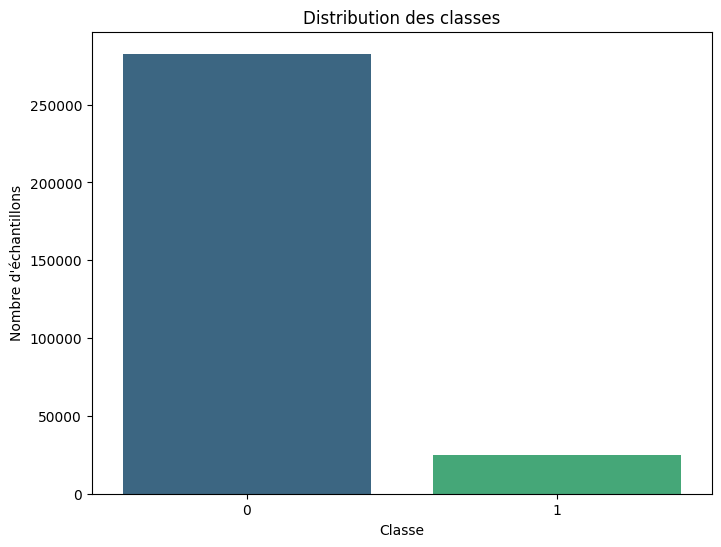

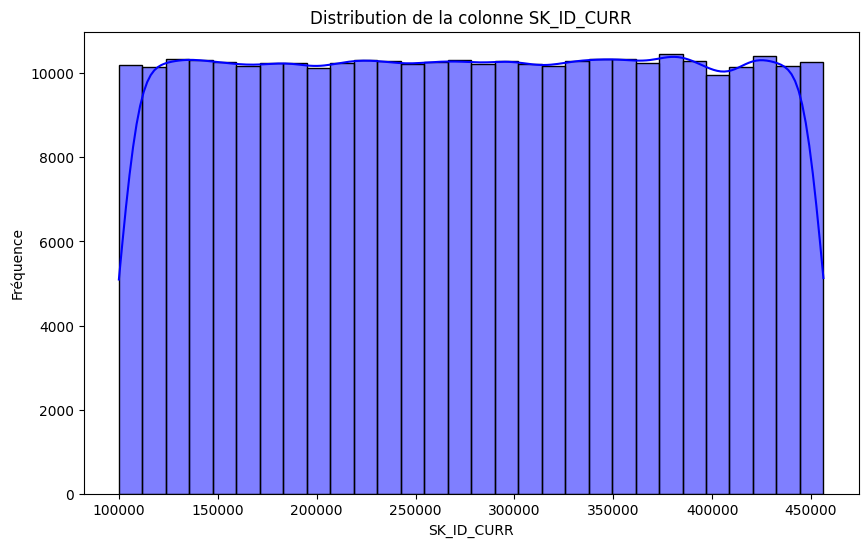

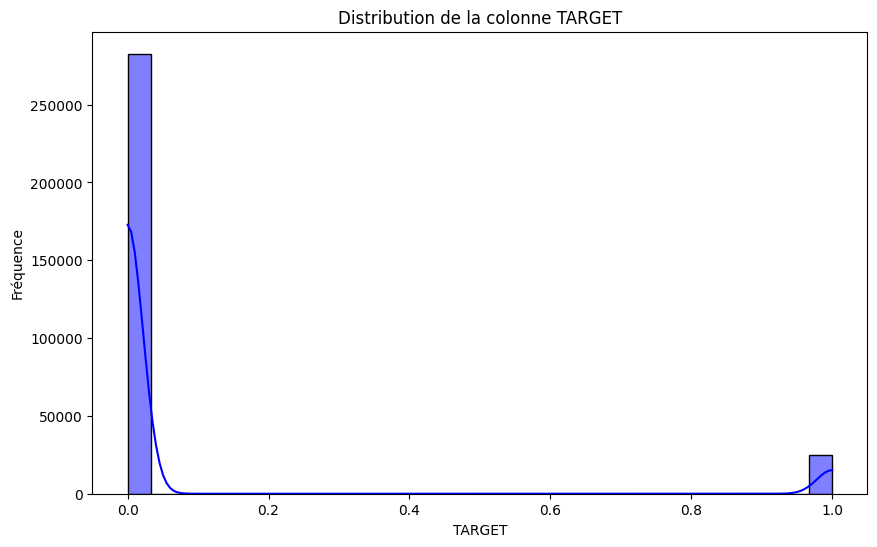

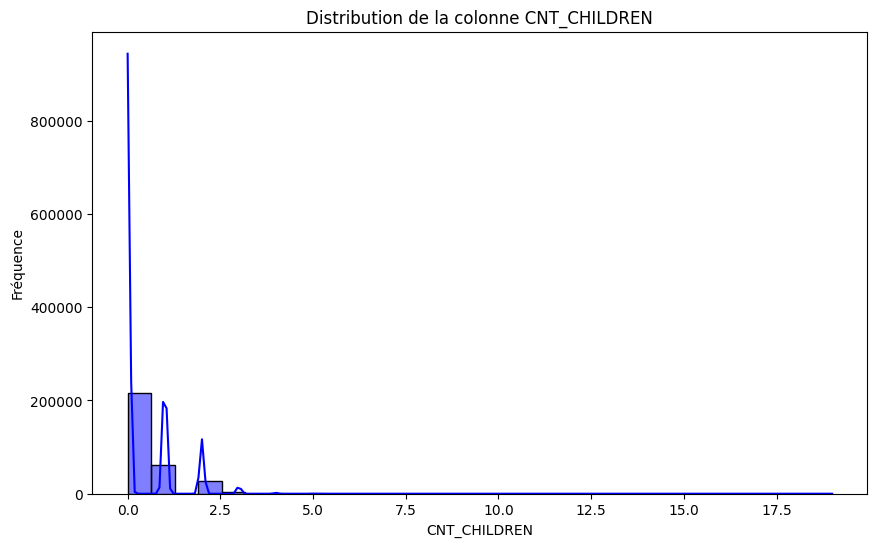

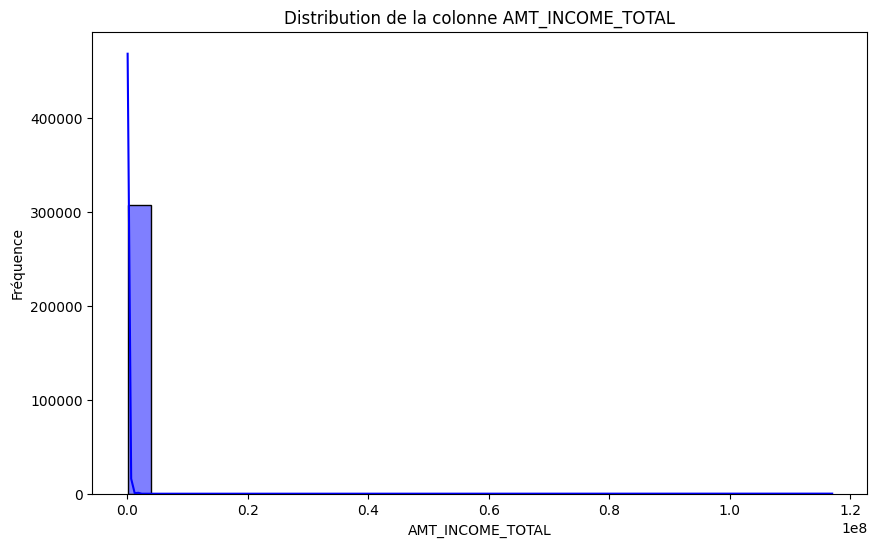

...

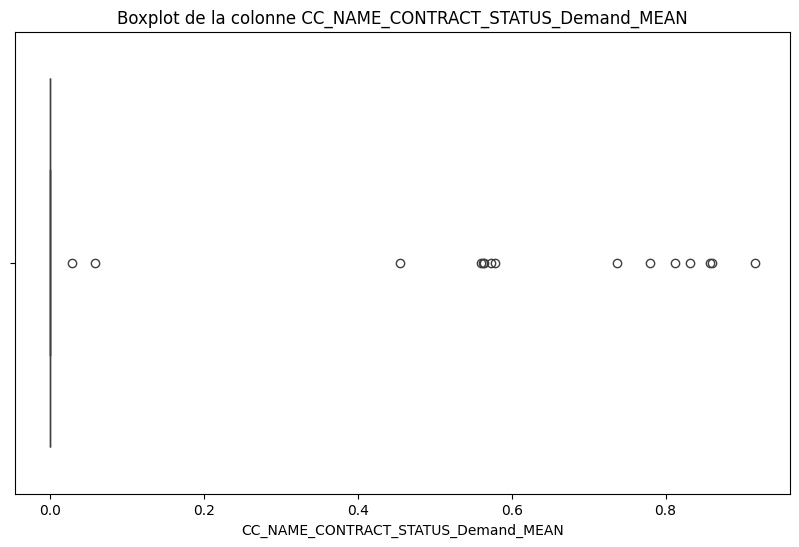

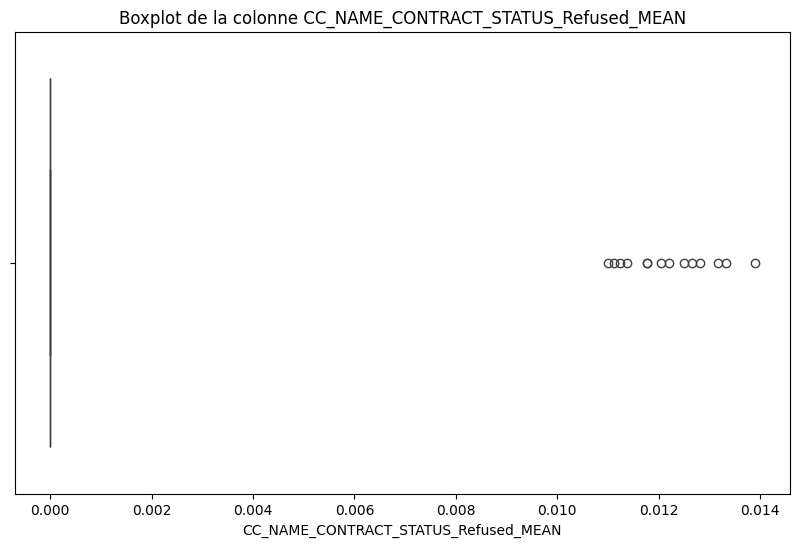

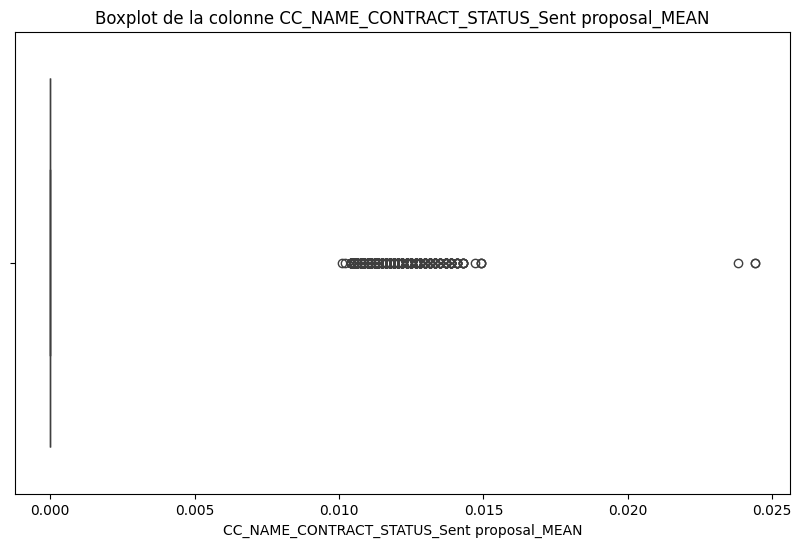

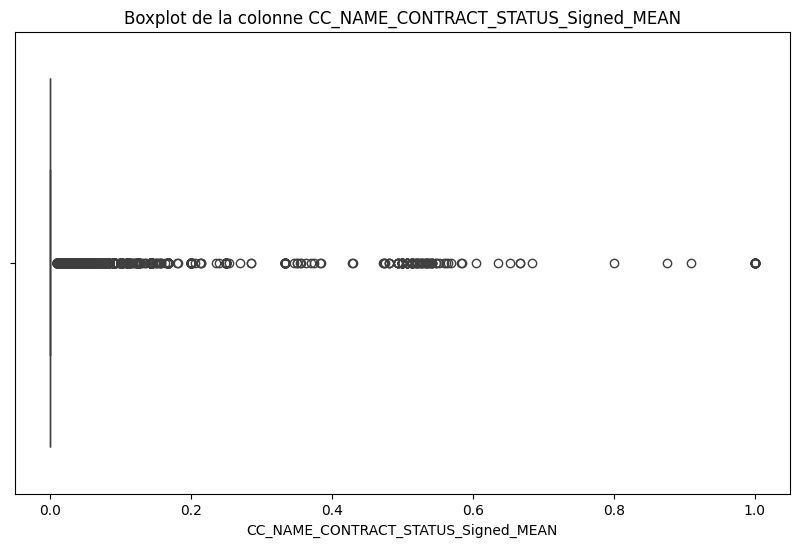

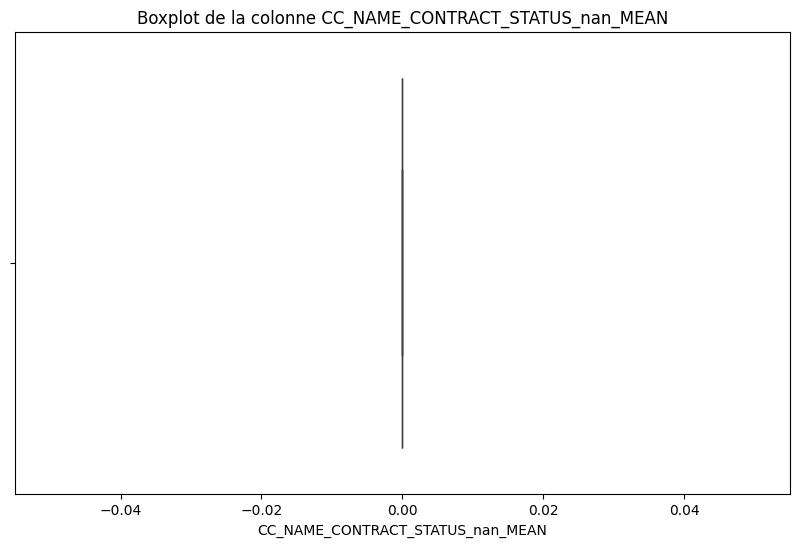

In [22]:
# Chemin vers le dossier où se trouve le fichier processed_data.csv
chemin_dossier = "C:/Users/paulm/Documents/GitHub/Projet7/data/"

# Charger les données
df = pd.read_csv(chemin_dossier + 'processed_data.csv')

# Vérifier les valeurs nulles
print("Valeurs nulles par colonne :")
print(df.isnull().sum())

# Afficher les statistiques descriptives
print("\nStatistiques descriptives :")
print(df.describe())

# Visualiser la distribution des classes
class_distribution = df['TARGET'].value_counts()
plt.figure(figsize=(8, 6))
sns.barplot(x=class_distribution.index, y=class_distribution.values, palette="viridis")
plt.title("Distribution des classes")
plt.xlabel("Classe")
plt.ylabel("Nombre d'échantillons")
plt.show()

# Visualiser les distributions de chaque colonne
numerical_columns = df.select_dtypes(include=[np.number]).columns

for col in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(df[col].dropna(), kde=True, bins=30, color="blue")
    plt.title(f'Distribution de la colonne {col}')
    plt.xlabel(col)
    plt.ylabel('Fréquence')
    plt.show()

# Afficher les boxplots pour détecter les valeurs extrêmes
for col in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot de la colonne {col}')
    plt.xlabel(col)
    plt.show()